# Movimiento de la Kinesina
La Kinesina es un motor molecular. Transforma energía de la molécula de ATP en trabajo mecánico útil para transportar vesículas a lo largo de microtúbulos al interior de las células en una dirección preferencial.
En este codigo se busca simular el movimiento de la kinesina a lo largo de un microtubulo mediante un el método de Leap Frog estadisitico impulsivo (método descrito en el paper Efficient Algorithms for Langevin and DPD Dynamics), replicando asi los resultados del paper Model for hand-over-hand motion of molecular motors

Kinesin is a molecular motor. It transforms energy from the ATP molecule into mechanical work useful for transporting vesicles along microtubules inside cells in a preferential direction.
In this code we seek to simulate the movement of kinesin along a microtubule by means of an impulsive statistical Leap Frog method (method described in the paper Efficient Algorithms for Langevin and DPD Dynamics), replicating the results of the paper Model for hand-over-hand motion of molecular motors.

In [2]:
import numpy as np
import matplotlib.pyplot as plt

In [4]:
%load_ext Cython

## Implementación del Leap Frog Estdistico impulsivo

El algoritmo es el siguiente:

\begin{aligned}
& v=v\left(t-\frac{1}{2} h\right)+a h \\
& \Delta v=-f v+\sqrt{f(2-f)\left(k_{\mathrm{B}} T_{\mathrm{ref}} / m\right)} \xi \\
& x(t+h)=x(t)+\left(v+\frac{1}{2} \Delta v\right) h \\
& v\left(t+\frac{1}{2} h\right)=v+\Delta v \\
\end{aligned}

Siendo a

\begin{aligned}
&a=-\nabla \frac{V_1(x, y)}{m}=-\nabla \frac{V_{1 x}(x)}{m}-\nabla \frac{V_{1 y}(y)}{m} \\
& -\nabla \frac{V_{1 y}(y)}{m}=-\frac{k_y}{m} y \quad \quad-\nabla \frac{V_{1 x}(x)}{m}= \begin{cases}-\frac{V_0}{m x_M} & \text { si } 0 \leq x \leq x_M, \\
\frac{V_0}{m\left(2 l_0-x_M\right)} & \text { si } x_M \leq x \leq 2 l_0 .\end{cases} \\
\end{aligned}

EL codigo fue implementado en cython. Cython es un compilador estático optimizador tanto para el lenguaje de programación Python como para el lenguaje de programación Cython extendido (basado en Pyrex). Hace que escribir extensiones C para Python sea tan fácil como el propio Python.

In [5]:
%%cython
import numpy as np
cimport numpy as np

def difusionC(double t_0, double t_f, int steps, np.ndarray[double, ndim=1] ci, np.ndarray[double, ndim=1] parameters, np.ndarray[double, ndim=1] state):
    """
    Simulates particle diffusion in a confined space using a Langevin equation with FENE potential.

    Parameters:
        t_0 (double): Initial time.
        t_f (double): Final time.
        steps (int): Number of simulation steps.
        ci (np.ndarray[double, ndim=1]): Initial conditions [x, vx, y, vy].
        parameters (np.ndarray[double, ndim=1]): Model parameters [gamma, T, m, V_o, x_m, l_o, ky].
        state (np.ndarray[double, ndim=1]): Array of random noise values.

    Returns:
        np.ndarray[double, ndim=1]: x-coordinates over time.
        np.ndarray[double, ndim=1]: x-velocities over time.
        np.ndarray[double, ndim=1]: y-coordinates over time.
        np.ndarray[double, ndim=1]: y-velocities over time.
    """
    cdef double dt = (t_f - t_0) / steps
    cdef np.ndarray[np.double_t, ndim=1] x = np.zeros(steps)
    cdef np.ndarray[np.double_t, ndim=1] y = np.zeros(steps)
    cdef np.ndarray[np.double_t, ndim=1] vx = np.zeros(steps + 1)
    cdef np.ndarray[np.double_t, ndim=1] vy = np.zeros(steps + 1)
    cdef double kb = 1.0
    cdef double alpha = 1.0 - np.exp(-parameters[0] * dt)
    cdef double l_2o = 2 * parameters[5]
    cdef double x_i = ci[0]

    cdef double m = parameters[2]
    cdef double V_o = parameters[3]
    cdef double x_m = parameters[4]
    cdef double ky = parameters[6]

    cdef int j = 0
    cdef double a

    # Initialize initial conditions
    x[0] = ci[0]
    y[0] = ci[2]
    vx[0] = ci[1] - (dt * V_o) / (2 * ((l_2o - x_m) * m))
    vx[1] = ci[1]
    vy[0] = ci[3] + (dt * ky * ci[2]) / (2 * m)
    vy[1] = ci[3]

    for i in range(1, steps):
        # Check position relative to x_m and l_2o
        if x_i <= x_m:
            ax = -V_o / (m * x_m) * state[i]
        elif x_i > x_m:
            ax = V_o / ((l_2o - x_m) * m) * state[i]
        elif x_i >= l_2o:
            j =+ 1
            ax = -V_o / (m * x_m) * state[i]

        ay = -1 * (ky * y[i - 1])

        # Calculate potential FENE (currently commented out)

        # Velocity coordinates
        v_xprim = vx[i] + ax * dt
        v_yprim = vy[i] + ay * dt

        # Update X coordinates
        delta_v = -alpha * v_xprim + (np.sqrt(alpha * (2 - alpha) * kb * parameters[1] / m)) * np.random.normal(0, 1)
        vx[i + 1] = v_xprim + delta_v
        x[i] = x[i - 1] + (v_xprim + 0.5 * delta_v) * dt
        x_i = x[i] - l_2o * j

        # Update Y coordinates
        delta_vy = -alpha * v_yprim + (np.sqrt(alpha * (2 - alpha) * kb * parameters[1] / m)) * np.random.normal(0, 1)
        vy[i + 1] = v_yprim + delta_vy
        y[i] = y[i - 1] + (v_yprim + 0.5 * delta_vy) * dt

    return x, vx[1:], y, vy[1:]


Content of stdout:
_cython_magic_6d76b5b9ab6c2f98d6898956914aedd0766e44f7.c
c:\Users\cterr\anaconda3\Lib\site-packages\numpy\core\include\numpy\npy_1_7_deprecated_api.h(14) : Warning Msg: Using deprecated NumPy API, disable it with #define NPY_NO_DEPRECATED_API NPY_1_7_API_VERSION
   Creando biblioteca C:\Users\cterr\.ipython\cython\Users\cterr\.ipython\cython\_cython_magic_6d76b5b9ab6c2f98d6898956914aedd0766e44f7.cp311-win_amd64.lib y objeto C:\Users\cterr\.ipython\cython\Users\cterr\.ipython\cython\_cython_magic_6d76b5b9ab6c2f98d6898956914aedd0766e44f7.cp311-win_amd64.exp
Generando código
Generación de código finalizada

In [6]:
# Simulation parameters
t_0, t_f = 0, 50
steps = int(t_f * 100)
t = np.linspace(t_0, t_f, steps)
# Initial conditions [x0, vx0, y0, vy0]
ci = np.array([0.0, 10.0, 0.0, 10.0])  
# [gamma, T, m, V_o, x_m, l_o, ky]
parameters = np.array([1.0, 4.0, 1.0, 5.0, 1.5, 1.0, 1.0])  
iterations = 1

#Definittion of the two states of the pontential
state1, state2 = np.zeros(steps), np.zeros(steps)
t_Pot = 500

for i in range(0, steps):
    if (i % (t_Pot * 3) <= t_Pot * 1.5):
        state2[i] = 0
    elif (i % (t_Pot * 3) <= t_Pot * 2.5):
        state2[i] = 1
    else:
        state2[i] = 0
    if (i % (t_Pot * 3) <= t_Pot):
        state1[i] = 1
    else:
        state1[i] = 0



In [7]:
%%time
results1 = []
results2 = []

# Simulate diffusion for each state (state1 and state2) for the specified number of iterations
for i in range(iterations):
    # Simulate diffusion with state1
    result_state1 = difusionC(t_0, t_f, steps, ci, parameters, state1)
    results1.append(result_state1)

    # Simulate diffusion with state2
    result_state2 = difusionC(t_0, t_f, steps, ci, parameters, state2)
    results2.append(result_state2)


CPU times: total: 109 ms
Wall time: 150 ms


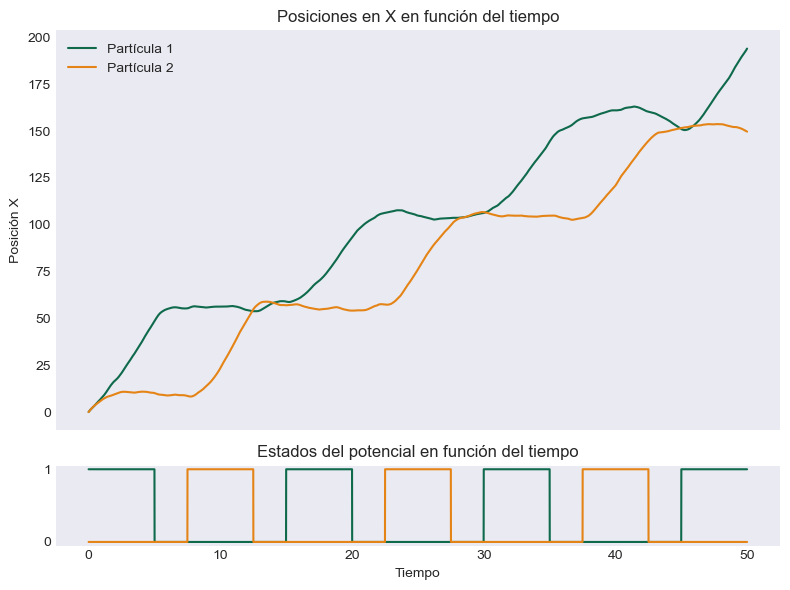

In [8]:
plt.style.use('seaborn-v0_8-dark')
fig, axs = plt.subplots(2, 1, figsize=(8, 6), gridspec_kw={'height_ratios': [5, 1]})

# Graph of the average of the positions
axs[0].plot(t, results1[i][0], color='#0E6A4B', label='Partícula 1')
axs[0].plot(t, results2[i][0], color='#E58416', label='Partícula 2')
axs[0].set_title('Posiciones en X en función del tiempo')
axs[0].set_ylabel('Posición X')
axs[0].legend()
axs[0].set_xticks([])

# Graph of the potential states
axs[1].plot(t, state1, color='#0E6A4B')
axs[1].plot(t, state2, color='#E58416')
axs[1].set_xlabel('Tiempo')
axs[1].set_title('Estados del potencial en función del tiempo')

# Ajuste del diseño del gráfico
plt.tight_layout()
plt.show()



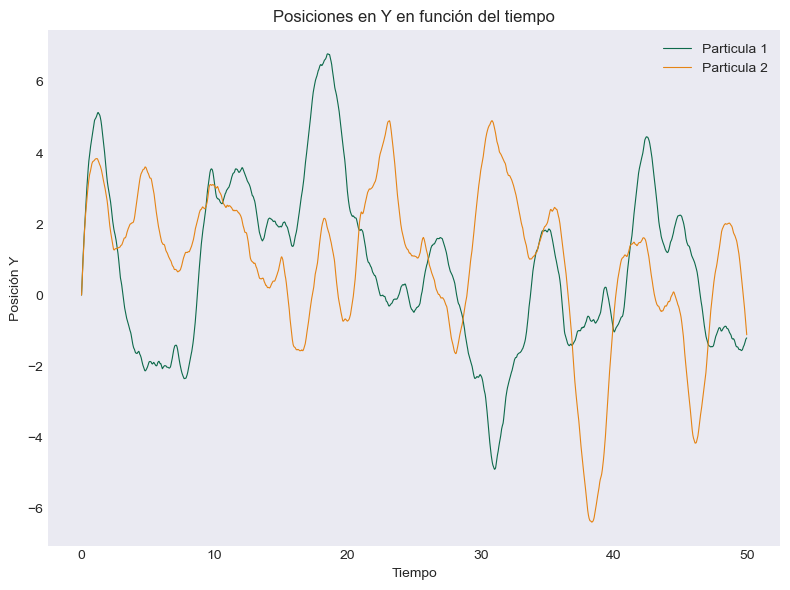

In [9]:

plt.figure(figsize=(8, 6))

# Trajectory plot in the XY plane for particles
plt.plot(results1[i][0], results1[i][2], color='#0E6A4B', label='Particula 1', linewidth=0.6)
plt.plot(results2[i][0], results2[i][2], color='#E58416', label='Particula 2', linewidth=0.6)

# Labels and title
plt.xlabel('Tiempo')
plt.ylabel('Posición Y')
plt.title('Posiciones en Y en función del tiempo')

# Show legend
plt.legend()

# Show the plot
plt.show()


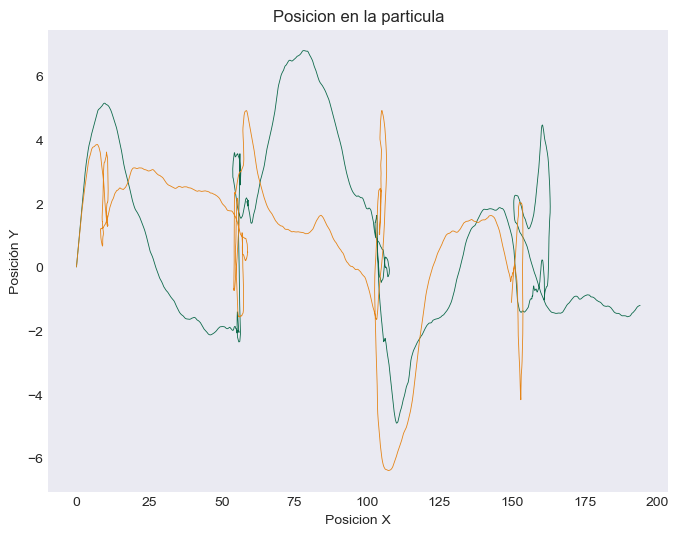

In [10]:
plt.figure(figsize=(8, 6))

# Trajectory plot in the XY plane for particles
plt.plot(results1[i][0], results1[i][2], color='#0E6A4B', label='Particula 1', linewidth=0.6)
plt.plot(results2[i][0], results2[i][2], color='#E58416', label='Particula 2', linewidth=0.6)

# Labels and title
plt.xlabel("Posicion X")
plt.ylabel("Posicion Y")
plt.title("Posicion de la articula en el plano XY")

# Show the plot
plt.show()


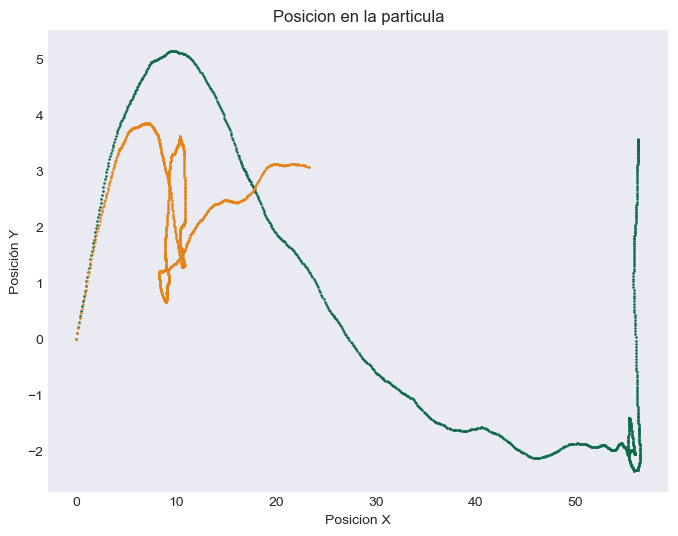

In [11]:
plt.figure(figsize=(8, 6))

# Scatter plot of the first 1000 points in the XY plane for particles
plt.scatter(results1[i][0][:1000], results1[i][2][:1000],color='#0E6A4B', label='Particula 1',s=0.8)#,linewidth = 0.6)
plt.scatter(results2[i][0][:1000], results2[i][2][:1000],color='#E58416', label='Particula 2',s=0.8)#,linewidth = 0.6)

# Labels and title
plt.xlabel("Posicion X")
plt.ylabel("Posicion Y")
plt.title("Posicion de la articula en el plano XY")

# Show the plot
plt.show()

MovieWriter imagemagick unavailable; using Pillow instead.


C:\Users\cterr\AppData\Local\Temp\ipykernel_10932\977697306.py:28: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(x, y)
C:\Users\cterr\AppData\Local\Temp\ipykernel_10932\977697306.py:28: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(x, y)


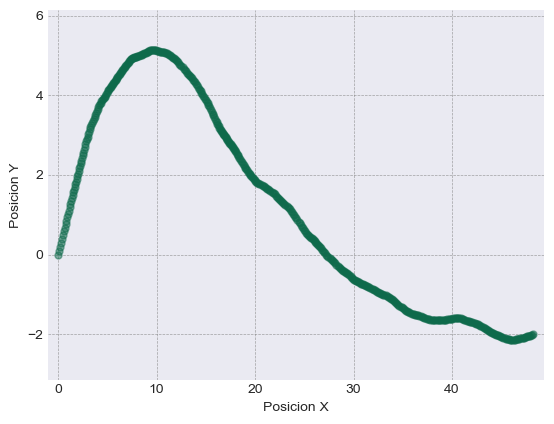

In [14]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Example data
vector1 = results1[0][0][:500]
vector2 = results2[0][2][:500]

# vector3 = results2[0][0][:400]
# vector4 = results2[0][2][:400]

# Initial configuration of the plot
fig, ax = plt.subplots()
line, = ax.plot([], [], 'o', markersize=5, alpha=0.9, color='#0E6A4B')

def init():
    ax.set_xlim(min(vector1) - 1, max(vector1) + 1)
    ax.set_ylim(min(vector2) - 1, max(vector2) + 1)
    ax.set_xlabel('Posicion X')
    ax.set_ylabel('Posicion Y')
    ax.grid(True, linestyle='--', linewidth=0.5, color='gray', alpha=0.7)
    return line,

def update(frame):
    x = vector1[frame]
    y = vector2[frame]

    line.set_data(x, y)

    # Update previous points with lower opacity
    if frame > 0:
        prev_x = vector1[:frame]
        prev_y = vector2[:frame]
        line.set_data(prev_x, prev_y)
        line.set_alpha(0.5)
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=len(vector1), init_func=init, blit=True)
ani.save('Kinesin_movement.gif', writer='imagemagick')
# Display the animation in Colab
HTML(ani.to_jshtml())
